# Ejemplo 13.3 del libro, Problema del Viajero

Dadas $m$ ciudades y una matriz simétrica $D$ de dimensiones $m \times m$, con entradas positivas representando las distancias entre las ciudades, supongamos que hay un viajero que vive en una ciudad y debe visitar las otras $m-1$ ciudades y luego regresar a la suya. ¿En qué orden debe visitar las ciudades para minimizar la distancia total recorrida? 

El enfoque naive sería ver todos los posibles caminos, pero para valores grandes de $m$, esto es intratable puesto que crece del orden $m!$. Es por esto que debemos implementar otro enfoque. Usaremos la implementación del ejemplo 13.3 del libro usando recocido simulado, cuyo objetivo será hallar el mínimo de la función distancia.

El espacio de estados será el conjunto de m-tuplas que representarán las posibles permutaciones de las ciudades y así el objetivo será hallar el $argmax$ de la función distancia.

## Paso 1: Construcción de la matriz de distancias y cómputo de la distancia de un camino

Los caminos vendrán representados como permutaciones de $m$ elementos en una lista.

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import random
import itertools

In [23]:
class PointSet:
    def __init__(self, m: int):
        # ejemplo con datos aleatorios
        self.m = m
        np.random.seed(67)
        self.distance_matrix = np.random.randint(10, 100, size=(m, m))
        np.fill_diagonal(self.distance_matrix, 0)
    
    def f(self, path: list) -> float:
        total_distance = 0
        for i in range(len(path) - 1):
            total_distance += self.distance_matrix[path[i], path[i + 1]]
        total_distance += self.distance_matrix[path[-1], path[0]]  # regresar al inicio
        return total_distance

In [24]:
print(PointSet(5).distance_matrix)

[[ 0 63 84 79 17]
 [99  0 45 32 99]
 [55 45  0 63 45]
 [64 41 65  0 43]
 [52 68 36 29  0]]


Primero implementamos la solución Naive, viendo por fuerza bruta todas las posibles permutaciones, empezando por la ciudad inicial 0.

In [27]:
def naive_solution(point_set: PointSet) -> list:
    elementos = range(1,point_set.m) 

    iterador_permutaciones = itertools.permutations(elementos)

    min_distance = float('inf')
    best_permutation = None
    for p in iterador_permutaciones:
        perm = list(p)
        perm = [0] + perm
        distance = point_set.f(perm)
        print(f"Permutacion: {perm}, Distancia: {distance}")
        if distance < min_distance:
            min_distance = distance
            best_permutation = perm
        
    return best_permutation, min_distance

In [44]:
print(naive_solution(PointSet(10)))

Permutacion: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Distancia: 403
Permutacion: [0, 1, 2, 3, 4, 5, 6, 7, 9, 8], Distancia: 435
Permutacion: [0, 1, 2, 3, 4, 5, 6, 8, 7, 9], Distancia: 469
Permutacion: [0, 1, 2, 3, 4, 5, 6, 8, 9, 7], Distancia: 500
Permutacion: [0, 1, 2, 3, 4, 5, 6, 9, 7, 8], Distancia: 446
Permutacion: [0, 1, 2, 3, 4, 5, 6, 9, 8, 7], Distancia: 525
Permutacion: [0, 1, 2, 3, 4, 5, 7, 6, 8, 9], Distancia: 503
Permutacion: [0, 1, 2, 3, 4, 5, 7, 6, 9, 8], Distancia: 520
Permutacion: [0, 1, 2, 3, 4, 5, 7, 8, 6, 9], Distancia: 490
Permutacion: [0, 1, 2, 3, 4, 5, 7, 8, 9, 6], Distancia: 476
Permutacion: [0, 1, 2, 3, 4, 5, 7, 9, 6, 8], Distancia: 476
Permutacion: [0, 1, 2, 3, 4, 5, 7, 9, 8, 6], Distancia: 537
Permutacion: [0, 1, 2, 3, 4, 5, 8, 6, 7, 9], Distancia: 412
Permutacion: [0, 1, 2, 3, 4, 5, 8, 6, 9, 7], Distancia: 494
Permutacion: [0, 1, 2, 3, 4, 5, 8, 7, 6, 9], Distancia: 461
Permutacion: [0, 1, 2, 3, 4, 5, 8, 7, 9, 6], Distancia: 449
Permutacion: [0, 1, 2, 3, 4, 5, 8, 9, 6,

## Paso 2: Construcción del Recocido Simulado

Para este paso necesitamos definir cuándo dos m-tuplas son configuraciones vecinas o no para permitir las transiciones en la cadena Metrópolis. El libro dice que $\eta$ es vecina de $\eta ´$ si existen $i,j \in \{1,...,m\}$ $i<j$ tal que 

$$\eta ´ = (\eta_1 ´, ..., \eta_m ´) = (\eta_1, ..., \eta_{i-1}, \eta_{j}, \eta_{j-1}, ..., \eta_{i+1}, \eta_{i}, \eta_{j+1}, ..., \eta_{m} ´)$$

Por ejemplo $(1,2,...,14) \approx (1,2,3,4,11,...,5,12,13,14)$ con $i = 5, j = 11$

In [47]:
class SimulatedAnnealing:
    def __init__(self, pointset: PointSet, cooling_constant: float = 1, n_cooldowns: int = 15):
        self.pointset = pointset
        self.cooling_schedule: list[float] = [cooling_constant*(0.95**n) for n in range(2, n_cooldowns + 2)]
        self.N_sequence: list[int] = [100 for n in range(2, n_cooldowns + 2)]
        self.energy_history = []
        self.temperature_history = []
        self.minimum_energy_history = []
    
    def get_neighbor(self, current_path: list) -> list:
        m = len(current_path)
        seleccion = random.sample(range(1, m), 2) # Sin reemplazo
        i, j = sorted(seleccion) # Ordenamos para garantizar i < j
        
        neighbor_path = current_path[:i] + current_path[i:j+1][::-1] + current_path[j+1:]
        return neighbor_path
    
    def accept_probability(self, current_cost: float, neighbor_cost: float, temperature: float) -> float:
        if neighbor_cost < current_cost:
            return 1.0
        else:
            return min(1.0, np.exp((current_cost - neighbor_cost) / temperature))
    
    def run(self):
        best_path = [0] + random.sample(range(1, self.pointset.m), self.pointset.m - 1)
        current_distance = self.pointset.f(best_path)
        minmimum_distance = current_distance
        iteration = 0
        
        for T, N in zip(self.cooling_schedule, self.N_sequence):
            print(f"Running iteration {iteration}th with temperature {T} and N {N}")
            
            for _ in range(N):
                neighbor_path = self.get_neighbor(best_path)
                neighbor_distance = self.pointset.f(neighbor_path)
                
                ap = self.accept_probability(current_distance, neighbor_distance, T)
                
                if random.random() < ap:
                    current_distance = neighbor_distance
                    
                    if current_distance < minmimum_distance:
                        best_path = neighbor_path
                        minmimum_distance = current_distance
        
                self.energy_history.append(current_distance)
                self.temperature_history.append(T)
                self.minimum_energy_history.append(minmimum_distance)
            iteration += 1
        
        return best_path, minmimum_distance     
    
    def plot_convergence(self):
        """Visualiza la convergencia del algoritmo."""
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 8))

        iterations = range(len(self.energy_history))

        # Gráfico de energía
        ax1.plot(iterations, self.energy_history, alpha=0.6,
                 linewidth=2, label='Distancia actual')
        ax1.plot(iterations, self.minimum_energy_history, 'r-',
                linewidth=1, label='Mejor distancia')
        ax1.set_xlabel('Iteración')
        ax1.set_ylabel('Distancia')
        ax1.set_title('Convergencia de Distancia')
        ax1.legend()
        ax1.grid(True, alpha=0.3)

        # Gráfico de temperatura
        ax2.plot(iterations, self.temperature_history, 'orange')
        ax2.set_xlabel('Iteración')
        ax2.set_ylabel('Temperatura')
        ax2.set_title('Esquema de Enfriamiento')
        ax2.grid(True, alpha=0.3)

        plt.tight_layout()
        plt.show()

Running iteration 0th with temperature 0.45125 and N 100
Running iteration 1th with temperature 0.42868749999999994 and N 100
Running iteration 2th with temperature 0.40725312499999994 and N 100
Running iteration 3th with temperature 0.3868904687499999 and N 100
Running iteration 4th with temperature 0.3675459453124999 and N 100
Running iteration 5th with temperature 0.34916864804687486 and N 100
Running iteration 6th with temperature 0.3317102156445311 and N 100
Running iteration 7th with temperature 0.31512470486230454 and N 100
Running iteration 8th with temperature 0.29936846961918934 and N 100
Running iteration 9th with temperature 0.28440004613822983 and N 100
Running iteration 10th with temperature 0.27018004383131833 and N 100
Running iteration 11th with temperature 0.2566710416397524 and N 100
Running iteration 12th with temperature 0.24383748955776477 and N 100
Running iteration 13th with temperature 0.23164561507987652 and N 100
Running iteration 14th with temperature 0.2200

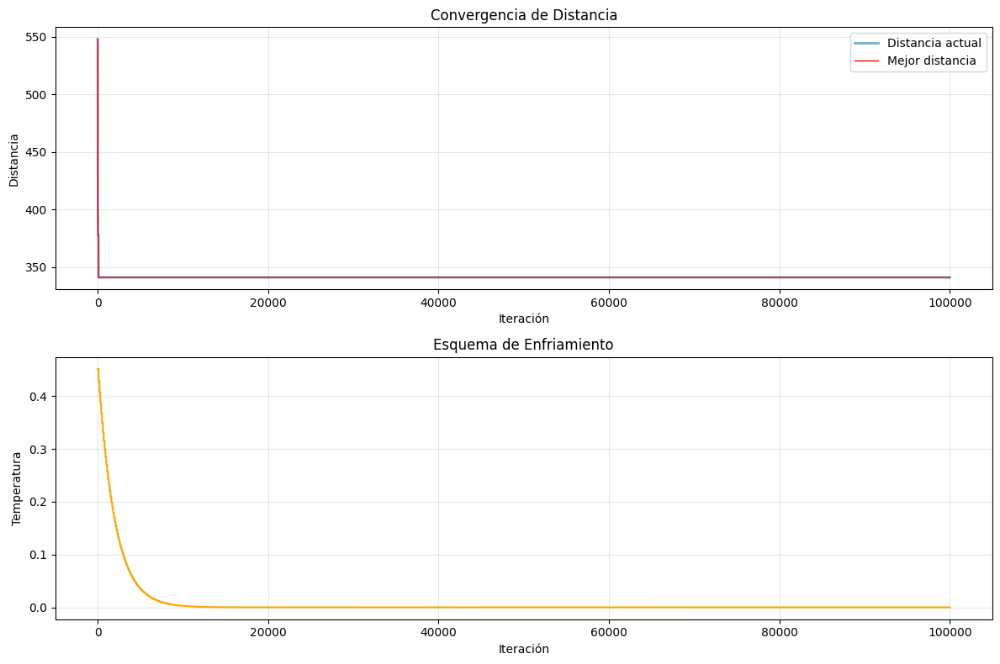

In [52]:
pointset = PointSet(10)
sa = SimulatedAnnealing(pointset, cooling_constant=0.5, n_cooldowns=1000)
print(sa.run())
sa.plot_convergence()